# **<p style="text-align: center;">Исследование объявлений о продаже квартир.</p>**

В проекте представлены данные от сервиса Яндекс.Недвижимость, представляющие собой архив объявлений о продаже жилых объектов в городе Санкт-Петербурге и его прилегающих населенных пунктах за последние несколько лет. Задача проекта заключается в разработке модели для определения рыночной стоимости недвижимости. Этот процесс предполагает проведение исследовательского анализа данных с целью выявления факторов, оказывающих влияние на цену жилых объектов. Этот анализ впоследствии позволит создать автоматизированную систему, способную обнаруживать аномалии и потенциальные случаи мошенничества.

Проект содержит два набора данных по каждой квартире на продажу. Первые вписаны пользователем, вторые — получены автоматически на основе картографических данных. Например, расстояние до центра, аэропорта и других объектов — эти данные автоматически получены из геосервисов. Количество парков и водоёмов также заполняется без участия пользователя.

## Откроем файл с данными и изучим общую информацию. 

### Импортируем необходимые библиотеки и загружаем данные в датафрейм.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
data = pd.read_csv('/datasets/real_estate_data.csv',sep='\t')
data.head()

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.0,2019-03-07T00:00:00,3,2.70,16.0,51.0,8,NaN,...,25.0,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.4,2018-12-04T00:00:00,1,NaN,11.0,18.6,1,NaN,...,11.0,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.0,2015-08-20T00:00:00,2,NaN,5.0,34.3,4,NaN,...,8.3,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.0,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,...,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.0,2018-06-19T00:00:00,2,3.03,14.0,32.0,13,NaN,...,41.0,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0


### Изучаем общую информацию о полученном датафрейме.

In [2]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        14504 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           21796 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          2775 non-null   object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               12180 non-null  float64
 14  locality_name         23650 non-null  object 
 15  airports_nearest   

### Переименуем столбец не соответствующий нужному формату.

In [3]:
data.rename(columns={'cityCenters_nearest' : 'city_centers_nearest'}, inplace=True)

### Построим общую гистограмму для всех числовых столбцов таблицы.

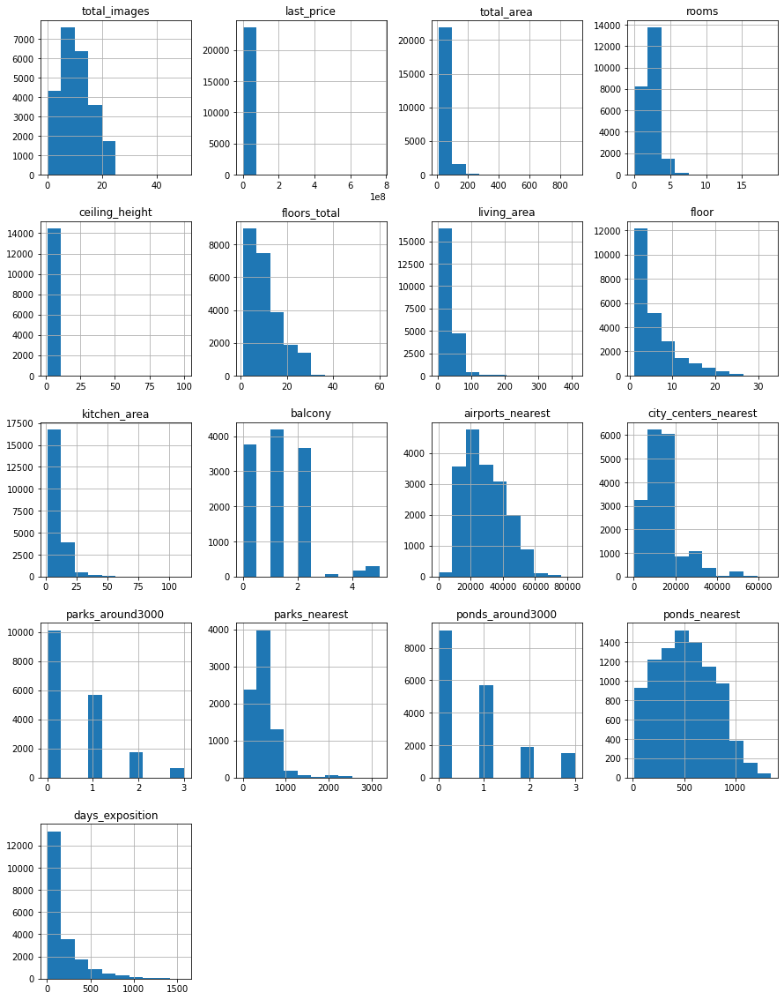

In [4]:
data.hist(figsize=(15, 20));

## Предобработка данных

### Найдем и изучим пропущенные значения в столбцах.

In [5]:
data.isna().sum()

total_images                0
last_price                  0
total_area                  0
first_day_exposition        0
rooms                       0
ceiling_height           9195
floors_total               86
living_area              1903
floor                       0
is_apartment            20924
studio                      0
open_plan                   0
kitchen_area             2278
balcony                 11519
locality_name              49
airports_nearest         5542
city_centers_nearest     5519
parks_around3000         5518
parks_nearest           15620
ponds_around3000         5518
ponds_nearest           14589
days_exposition          3181
dtype: int64

In [6]:
data.loc[data['ceiling_height'] <= 2.4].sort_values(by='ceiling_height').head()

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,city_centers_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
22590,16,6000000.0,55.0,2018-10-31T00:00:00,2,1.00,12.0,32.4,7,NaN,...,10.00,NaN,Санкт-Петербург,33053.0,14217.0,2.0,293.0,2.0,289.0,13.0
5712,5,1500000.0,42.8,2017-08-14T00:00:00,2,1.20,2.0,27.5,1,NaN,...,5.20,NaN,городской посёлок Мга,NaN,NaN,NaN,NaN,NaN,NaN,248.0
16934,5,4100000.0,40.0,2017-10-17T00:00:00,1,1.75,37.0,17.4,5,NaN,...,8.34,NaN,Санкт-Петербург,18732.0,20444.0,0.0,NaN,3.0,80.0,71.0
19098,7,2700000.0,56.0,2018-02-04T00:00:00,3,2.00,5.0,46.0,1,NaN,...,6.00,NaN,Выборг,NaN,NaN,NaN,NaN,NaN,NaN,282.0
552,11,2999000.0,33.5,2017-03-30T00:00:00,1,2.00,15.0,17.5,6,NaN,...,6.50,NaN,Санкт-Петербург,33972.0,11746.0,1.0,520.0,1.0,949.0,270.0


In [7]:
data.loc[data['ceiling_height'] >= 5.6].sort_values(by='ceiling_height').head()

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,city_centers_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
1388,20,59800000.0,399.0,2015-01-21T00:00:00,5,5.6,6.0,NaN,6,NaN,...,NaN,0.0,Санкт-Петербург,26204.0,6934.0,2.0,149.0,2.0,577.0,719.0
21227,0,8200000.0,71.0,2017-07-21T00:00:00,0,5.8,5.0,68.0,5,NaN,...,NaN,0.0,Санкт-Петербург,20170.0,1261.0,2.0,295.0,3.0,366.0,30.0
20264,17,119000000.0,187.6,2017-07-10T00:00:00,4,6.0,7.0,147.0,7,NaN,...,15.6,NaN,Санкт-Петербург,26902.0,5605.0,3.0,484.0,1.0,305.0,259.0
3474,3,1400000.0,30.0,2018-03-16T00:00:00,1,8.0,5.0,15.3,2,False,...,7.3,NaN,деревня Нурма,NaN,NaN,NaN,NaN,NaN,NaN,125.0
17442,0,5350000.0,54.0,2015-06-16T00:00:00,2,8.0,5.0,29.0,2,NaN,...,NaN,1.0,Красное Село,24638.0,28062.0,0.0,NaN,0.0,NaN,469.0


*Обработаем выявленые пропуски в столбце:* **ceiling_height(высота потолков,м)** - 9195 значений.  
Отфильтруем эти значения по min и max высоте. Получим следующие данные:  
- low_ceiling - 44 значения
- high_ceiling - 32 значения



### Устраним редкие и выбивающиеся значения в high_ceiling .

Для квартир с высотой потолков от 24 до 56 метров предполагаем, что это опечатка и делим на 10, получая 2.4 и 5.6 метра соответственно.
Удаляем квартиры с высотой потолков от 5.6 до 24 метров.
Удаляем квартиры с высотой потолков от 56 метров.
Смотрим  описательную статистику по столбцу ceiling_height и убеждаемся,что min и max соответствует норме.

In [8]:
data.update(data[(data['ceiling_height'] >= 24) & (data['ceiling_height'] <= 56)]['ceiling_height']/10)
data.drop(index=data.query('ceiling_height > 5.6 and ceiling_height < 24').index,inplace=True)
data.drop(index=data.query('ceiling_height > 56').index,inplace=True)
data['ceiling_height'].describe()

count    14493.000000
mean         2.725976
std          0.276893
min          1.000000
25%          2.510000
50%          2.650000
75%          2.800000
max          5.600000
Name: ceiling_height, dtype: float64

### Заполним пропущенные значения там, где это возможно.

В столбце balcony 11515 пропущенных значений. Предположим, если продавец не указал число балконов, то, скорее всего, в его квартире их нет. Такие пропуски правильно заменить на 0.

In [9]:
data['balcony'] = data['balcony'].fillna (0)

В столбце is_apartment 20915 пропущенных значений.Заполним пропуски в этом столбце на 'False'.

In [10]:
data['is_apartment'] = data['is_apartment'].fillna('False')

В столбце locality_name 49 пропущенных значений. Так как сумма пропусков в данном столбце незначительная,удаляем эти пропущенные значения.

In [11]:
data.dropna(subset=['locality_name'], inplace=True)

В столбце floors_total 86 пропущенных значений. Так как сумма пропусков в данном столбце незначительная,удаляем эти пропущенные значения.

In [12]:
data.dropna(subset=['floors_total'], inplace=True)

Обработаем пропуски в столбце жилая площадь в квадратных метрах. Проанализировав описательную статистику столбца living_area выявлено: большое количество квартир с жилой площадью от 10 до 60 кв.м.Отсортируем квартиры с жилой площадью меньше 10 кв.м. - их 25 квартир, есть даже квартиры с с жилой площадью 2 кв.м. Будем считать,что  это опечатка в площади. Отбросим значения с жилой площадью меньше 10 кв.м. Максимальная общая площадь 409 кв.м, отбросим квартиры с площадью более 300 кв.м.,таких 7 квартир.
Жилая площадь сильно коррелирует с общей площадью, поэтому посчитаем коэффициенты отношений жилых площадей к общим по объявлениям где заполнены обе площади, возьмем медиану этих коэффициентов и с помощью медианы восстановим пропуски, умножив общую площадь на эту медиану.

Обработаем пропуски в столбце площадь кухни в квадратных метрах. Проанализировав описательную статистику столбца kitchen_area выявлено:  11 квартир,в которых кухня меньше 3 кв.м. Квартиры,у котрых площадь кухни 5 кв.м.:  357. Квартиры  кухни которых площадью более 50 кв.м.: 44. Удалим строки с квартирами,кухни которых менее 3 кв.м. и больше 50 кв.м. Площадь кухни сильно коррелирует с общей площадью, поэтому посчитаем коэффициенты отношений площадь кухни к общим по объявлениям где заполнены обе площади, возьмем медиану этих коэффициентов и с помощью медианы восстановим пропуски, умножив общую площадь на эту медиану.

</div>

In [13]:
data['living_area'].describe()

count    21689.000000
mean        34.450640
std         22.034639
min          2.000000
25%         18.600000
50%         30.000000
75%         42.300000
max        409.700000
Name: living_area, dtype: float64

In [14]:
print('Жилая площадь меньше 10 кв.м.: ',data.query('living_area < 10')['living_area'].count())
print('Жилая площадь больше 300: ',data.query('living_area > 300')['living_area'].count())

data.drop(index=data.query('living_area < 10').index,inplace=True)
data.drop(index=data.query('living_area > 300').index,inplace=True)

Жилая площадь меньше 10 кв.м.:  25
Жилая площадь больше 300:  7


In [15]:
data['ratio_living_area'] = data['living_area'] / data['total_area']
data['living_area'] = data['living_area'].fillna(data['ratio_living_area'].median() * data['total_area'])

In [16]:
data['kitchen_area'].describe()

count    21306.000000
mean        10.540153
std          5.813479
min          1.300000
25%          7.000000
50%          9.100000
75%         12.000000
max        107.000000
Name: kitchen_area, dtype: float64

In [17]:
print('Площадь кухни меньше 3 кв.м.: ',data.query('kitchen_area < 3')['living_area'].count())
print('Площадь кухни 5 кв.м.: ',data.query('kitchen_area == 5')['living_area'].count())
print('Площадь кухни больше 50 кв.м.: ',data.query('kitchen_area > 50')['living_area'].count())

Площадь кухни меньше 3 кв.м.:  11
Площадь кухни 5 кв.м.:  357
Площадь кухни больше 50 кв.м.:  44


In [18]:
data.drop(index=data.query('kitchen_area < 3').index,inplace=True)
data.drop(index=data.query('kitchen_area > 50').index,inplace=True)

In [19]:
data['ratio_kitchen_area'] = data['kitchen_area'] / data['total_area']
data['kitchen_area'] = data['kitchen_area'].fillna(data['ratio_kitchen_area'].median() * data['total_area'])

### Рассмотрим типы данных в каждом столбце. Найдем столбцы, в которых нужно изменить тип данных. Преобразуем тип данных в выбранных столбцах.

In [20]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23467 entries, 0 to 23698
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23467 non-null  int64  
 1   last_price            23467 non-null  float64
 2   total_area            23467 non-null  float64
 3   first_day_exposition  23467 non-null  object 
 4   rooms                 23467 non-null  int64  
 5   ceiling_height        14411 non-null  float64
 6   floors_total          23467 non-null  float64
 7   living_area           23467 non-null  float64
 8   floor                 23467 non-null  int64  
 9   is_apartment          23467 non-null  object 
 10  studio                23467 non-null  bool   
 11  open_plan             23467 non-null  bool   
 12  kitchen_area          23467 non-null  float64
 13  balcony               23467 non-null  float64
 14  locality_name         23467 non-null  object 
 15  airports_nearest   

Сменить тип данных для: last_price, first_day_exposition, floors_total, is_apartment, balcony,days_exposition.
Изменяем тип данных в столбце first_day_exposition  на datetime, чтобы работать с датой в дальнейшем было удобно.
Изменение типов во всех остальных случаях необходимо, чтобы сэкономить память.

In [21]:
data['last_price'] = data['last_price'].astype(int)  
data['first_day_exposition'] = pd.to_datetime(data['first_day_exposition'],format='%Y-%m-%dT%H:%M:%S')
data['floors_total'] = data['floors_total'].astype('Int64')
#data['is_apartment'] = data['is_apartment'].map({'False':False, 'True':True})
data['days_exposition'] = np.floor(pd.to_numeric(data['days_exposition'], errors='coerce')).astype('Int64')


Параметр is_apartment приводим к типу bool.

In [22]:
data['is_apartment'] = data['is_apartment'].astype(bool)

Проверяем,что тип данных успешно изменен.

In [23]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23467 entries, 0 to 23698
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   total_images          23467 non-null  int64         
 1   last_price            23467 non-null  int64         
 2   total_area            23467 non-null  float64       
 3   first_day_exposition  23467 non-null  datetime64[ns]
 4   rooms                 23467 non-null  int64         
 5   ceiling_height        14411 non-null  float64       
 6   floors_total          23467 non-null  Int64         
 7   living_area           23467 non-null  float64       
 8   floor                 23467 non-null  int64         
 9   is_apartment          23467 non-null  bool          
 10  studio                23467 non-null  bool          
 11  open_plan             23467 non-null  bool          
 12  kitchen_area          23467 non-null  float64       
 13  balcony         

### Изучим уникальные значения в столбце locality_name и устраним неявные дубликаты. Например,  «поселок Тельмана» и «посёлок Тельмана» — это обозначения одних и тех же населённых пунктов. Заменим названия в существующем столбце.

In [24]:
locality_name = data.locality_name.unique()
locality_name

array(['Санкт-Петербург', 'посёлок Шушары', 'городской посёлок Янино-1',
       'посёлок Парголово', 'посёлок Мурино', 'Ломоносов', 'Сертолово',
       'Петергоф', 'Пушкин', 'деревня Кудрово', 'Коммунар', 'Колпино',
       'поселок городского типа Красный Бор', 'Гатчина', 'поселок Мурино',
       'деревня Фёдоровское', 'Выборг', 'Кронштадт', 'Кировск',
       'деревня Новое Девяткино', 'посёлок Металлострой',
       'посёлок городского типа Лебяжье',
       'посёлок городского типа Сиверский', 'поселок Молодцово',
       'поселок городского типа Кузьмоловский',
       'садовое товарищество Новая Ропша', 'Павловск',
       'деревня Пикколово', 'Всеволожск', 'Волхов', 'Кингисепп',
       'Приозерск', 'Сестрорецк', 'деревня Куттузи', 'посёлок Аннино',
       'поселок городского типа Ефимовский', 'посёлок Плодовое',
       'деревня Заклинье', 'поселок Торковичи', 'поселок Первомайское',
       'Красное Село', 'посёлок Понтонный', 'Сясьстрой', 'деревня Старая',
       'деревня Лесколово', '

In [25]:
data['locality_name'] = data['locality_name'].str.replace('ё','е').str.lower() 
data['locality_name'].unique()

array(['санкт-петербург', 'поселок шушары', 'городской поселок янино-1',
       'поселок парголово', 'поселок мурино', 'ломоносов', 'сертолово',
       'петергоф', 'пушкин', 'деревня кудрово', 'коммунар', 'колпино',
       'поселок городского типа красный бор', 'гатчина',
       'деревня федоровское', 'выборг', 'кронштадт', 'кировск',
       'деревня новое девяткино', 'поселок металлострой',
       'поселок городского типа лебяжье',
       'поселок городского типа сиверский', 'поселок молодцово',
       'поселок городского типа кузьмоловский',
       'садовое товарищество новая ропша', 'павловск',
       'деревня пикколово', 'всеволожск', 'волхов', 'кингисепп',
       'приозерск', 'сестрорецк', 'деревня куттузи', 'поселок аннино',
       'поселок городского типа ефимовский', 'поселок плодовое',
       'деревня заклинье', 'поселок торковичи', 'поселок первомайское',
       'красное село', 'поселок понтонный', 'сясьстрой', 'деревня старая',
       'деревня лесколово', 'поселок новый свет

Заменим букву ё на е в слове посёлок в колонке locality_name, а так же названия населённых пунктов приводим к нижнему регистру.

  
В столбце locality_name выявлены неявные дубликаты, избавимся от них. Заменяем "городской поселок" на "поселок","поселок городского типа" на "поселок" . 

In [26]:
duplicate_village = data.loc[data['locality_name'].str.contains('поселок')]
urban_village = data.loc[data['locality_name'].str.contains('поселок городского типа')]
urban_settlement = data.loc[data['locality_name'].str.contains('городской поселок')]

print('Количество уникальных названий населённых пунктов,которые содержат тип поселок:', duplicate_village['locality_name'].unique().size)
print('Количество уникальных названий населённых пунктов,которые содержат тип поселок городского типа:', urban_village['locality_name'].unique().size)
print('Количество уникальных названий населённых пунктов,которые содержат тип городской поселок:', urban_settlement['locality_name'].unique().size)

Количество уникальных названий населённых пунктов,которые содержат тип поселок: 167
Количество уникальных названий населённых пунктов,которые содержат тип поселок городского типа: 30
Количество уникальных названий населённых пунктов,которые содержат тип городской поселок: 13


In [27]:
data['locality_name'] = data['locality_name'].str.replace('городской поселок', 'поселок')
data['locality_name'] = data['locality_name'].str.replace('поселок городского типа', 'поселок')


In [28]:
data['locality_name'].value_counts().head(20)

санкт-петербург            15564
поселок мурино               550
поселок шушары               438
всеволожск                   398
пушкин                       364
колпино                      338
поселок парголово            327
гатчина                      307
деревня кудрово              299
выборг                       237
петергоф                     201
сестрорецк                   182
красное село                 175
кудрово                      171
деревня новое девяткино      143
сертолово                    142
ломоносов                    133
кириши                       125
поселок бугры                113
сланцы                       112
Name: locality_name, dtype: int64

## Посчитайте и добавьте в таблицу новые столбцы

### Добавим в таблицу новый столбец  price_os_meter со следующими параметрами: цена одного квадратного метра.

In [33]:
data['price_os_meter'] = data['last_price'] / data['total_area']

### Добавим в таблицу новый столбец  day_week_publication со следующими параметрами: день недели публикации объявления (0 — понедельник, 1 — вторник и так далее).

In [34]:
data['day_week_publication'] = data['first_day_exposition']. dt.weekday

### Добавим в таблицу новый столбец  month_publication со следующими параметрами: месяц публикации объявления.

In [35]:
data['month_publication'] = data['first_day_exposition'].dt.month

### Добавим в таблицу новый столбец  year_publication со следующими параметрами: год публикации объявления.

In [36]:
data['year_publication'] = data['first_day_exposition'].dt.year

### Добавим в таблицу новый столбец  type _floor со следующими параметрами:тип этажа квартиры (значения — «первый», «последний», «другой»).

In [37]:
data['type_floor'] = np.where(data['floor'] == 1, 'первый', 'другой')
data['type_floor'] = np.where(data['floor'] == data['floors_total'], 'последний', data['type_floor'])

### Добавим в таблицу новый столбец distance_to_center_km со следующими параметрами: расстояние до центра города в километрах (переведем из м в км и округлите до целых значений).

In [38]:
data['distance_to_center_km'] = data['city_centers_nearest'] // 1000

## Проведите исследовательский анализ данных

### Изучим следующие параметры объектов: общая площадь.

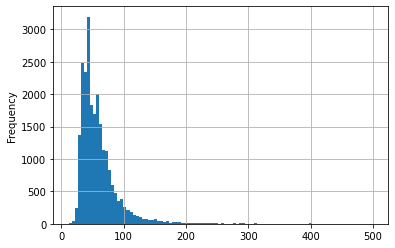

In [39]:
data['total_area'].plot(kind='hist', bins=100, grid=True);

Изучив общую площадь продаваемых квартир можно сделать вывод,что чаще встречаются квартиры с площадью в диапазоне 18-60(м²),редко встречающееся  значение 100 и более (м²).

**Изучим следующие параметры объектов: жилая площадь.**

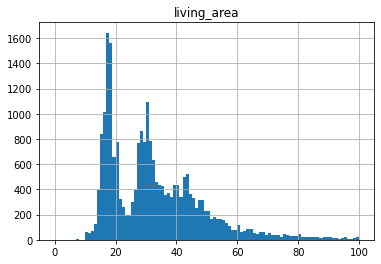

In [40]:
data.hist('living_area', bins=100, range=(0,100));

Изучив жилую площадь продаваемых квартир можно сделать вывод,наблюдаем скачки данных в дианазоне 16-18(м²),20-21(м²),30-31(м²).Пик данных расположен в диапазоне 16-18(м²),такие квартиры чаще востребованны на рынке недвижимости.

**Изучим следующие параметры объектов: площадь кухни.**

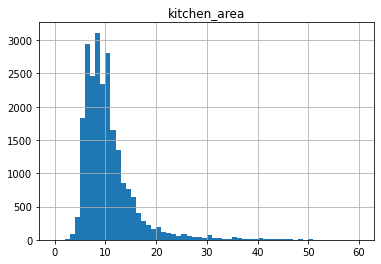

In [41]:
data.hist('kitchen_area', bins=60, range=(0,60));

Изучив площадь кухни продаваемых квартир можно сделать вывод,наблюдаем скачки данных в дианазоне 7-12(м²),пик данных расположен в 8(м²) - квартиры с такой площадью кухни встречаются чаще всего.

**Изучим следующие параметры объектов: цена объекта.**

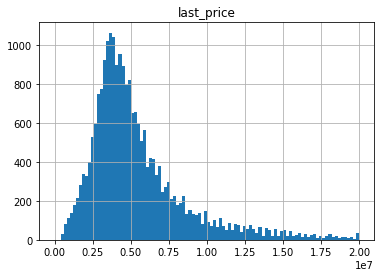

In [42]:
data.hist('last_price', bins=100, range=(0,2e+07));

Изучив ценy объекта, можно сделать вывод,что самые востребованные квартиры на рынке недвижимоти в диапазоне 2,7-4 млн. рублей.

**Изучим следующие параметры объектов: количество комнат.**

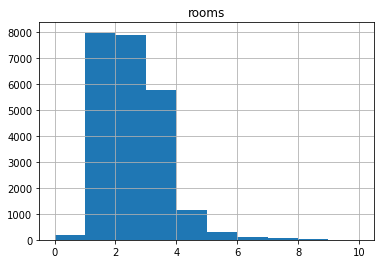

In [43]:
data.hist('rooms', bins=10, range=(0,10));

Изучив параметр объекта: количество комнат, можно сделать вывод,что самые востребованные квартиры на рынке недвижимоти: однокомнатные,двухкомнатные,трехкомнатные квартиры.

**Изучим следующие параметры объектов: высота потолков.**

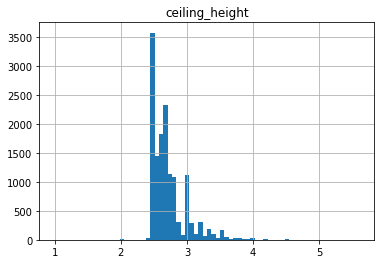

In [44]:
data.hist('ceiling_height', bins=70);

Изучив параметр: высота потолков, можно сделать вывод,что стандартная высота потолков в диапазоне 2,4 -2,8(м).

**Изучим следующие параметры объектов: этаж квартиры.**

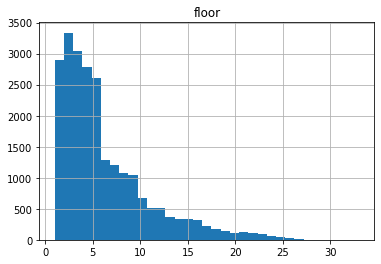

In [45]:
data.hist('floor', bins=data['floor'].max());

Изучив параметр объектов: этаж квартиры, можно сделать вывод,что чаще встречаются дома трехэтажные,четырехэтажные,пятиэтажные.

**Изучим следующие параметры объектов: тип этажа квартиры («первый», «последний», «другой»).**

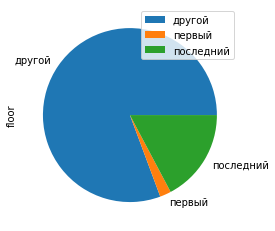

In [46]:
data.groupby(['type_floor']). sum ().plot(kind='pie', y='floor');

Изучив параметр объектов: этаж квартиры («первый», «последний», «другой»), можно сделать вывод,что чаще встречаются дома трехэтажные,четырехэтажные,пятиэтажные.

**Изучим следующие параметры объектов: общее количество этажей в доме.**

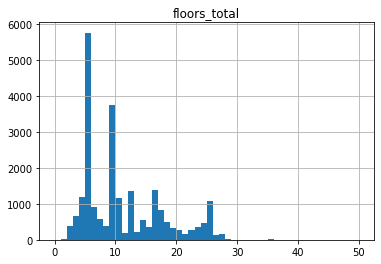

In [47]:
data.hist('floors_total',  bins=50, range=(0,50));

Изучив параметр объектов: общее количество этажей в доме, можно сделать вывод,что чаще встречаются дома девятиэтажные.

**Изучим следующие параметры объектов: расстояние до центра города в метрах.**

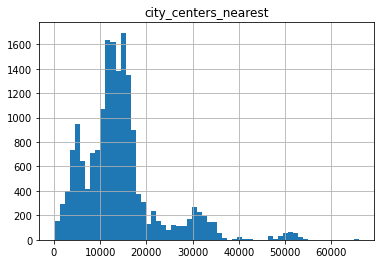

In [48]:
data.hist('city_centers_nearest', bins=60);

Изучив параметр объектов: расстояние до центра города в метрах, можно сделать вывод,что наблюдаются два пика, один маленький, 5км и другой побльшой от 10 км. до 15 км. Так же есть совсем небольшие всплески на 30 км. и 50 км.

**Изучим следующие параметры объектов: расстояние до ближайшего аэропорта.**

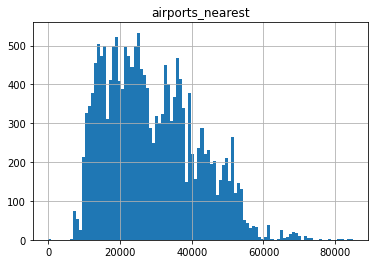

In [49]:
data.hist('airports_nearest', bins=100);

Изучив параметр объектов: расстояние до ближайшего аэропорта в метрах, можно сделать вывод,что пиков на графике много,в основном данные сосредоточенны в диапазоне 18-40 км.

**Изучим следующие параметры объектов: расстояние до ближайшего парка.**

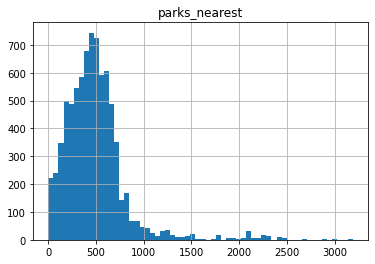

In [50]:
data.hist('parks_nearest', bins=60);

Изучив параметр объектов: расстояние до ближайшего парка в метрах, можно сделать вывод,что пик данных наблюдается в диапазоне 3-7 км.

**Изучим следующие параметры объектов: день и месяц публикации объявления.**

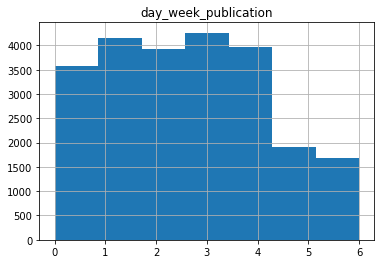

In [51]:
data.hist('day_week_publication', bins=7);

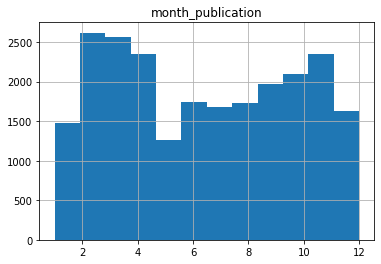

In [52]:
data.hist('month_publication', bins=12);

Изучив параметр объектов: день и месяц публикации объявления, можно сделать вывод,что пик публикаций приходится на диапазон вторник-пятница.Если смотреть динамику по месяцам,то пик публикаций в февраль-май,октябрь-ноябрь. 

### Посмотрим описательную статистику  с помощью describe() и построим диаграммы размаха.

In [53]:
data.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,...,ponds_around3000,ponds_nearest,days_exposition,ratio_living_area,ratio_kitchen_area,price_os_meter,day_week_publication,month_publication,year_publication,distance_to_center_km
count,23467.000000,2.346700e+04,23467.000000,23467.000000,14411.000000,23467.000000,23467.000000,23467.000000,23467.000000,23467.000000,...,17971.000000,8981.000000,20311.000000,21604.000000,21251.000000,2.346700e+04,23467.000000,23467.000000,23467.000000,17970.000000
mean,9.868539,6.407752e+06,59.904709,2.066647,2.723948,10.680189,34.386657,5.876209,10.369010,0.593514,...,0.767681,518.681439,180.574713,0.565499,0.186797,9.899202e+04,2.568628,6.403631,2017.371373,13.717641
std,5.675707,1.000503e+07,33.348346,1.067758,0.273633,6.594515,21.189215,4.869985,5.444182,0.959939,...,0.937058,277.728001,219.607070,0.104298,0.071644,4.908938e+04,1.787818,3.492091,1.037285,8.616092
min,0.000000,1.219000e+04,12.000000,0.000000,1.000000,1.000000,7.390041,1.000000,2.065574,0.000000,...,0.000000,13.000000,1.000000,0.141304,0.025381,1.118349e+02,0.000000,1.000000,2014.000000,0.000000
25%,6.000000,3.400000e+06,40.000000,1.000000,2.510000,5.000000,19.000000,2.000000,7.000000,0.000000,...,0.000000,294.000000,45.000000,0.496552,0.133333,7.650934e+04,1.000000,3.000000,2017.000000,9.000000
50%,9.000000,4.600000e+06,52.000000,2.000000,2.650000,9.000000,30.000000,4.000000,9.000000,0.000000,...,0.000000,503.000000,95.000000,0.568627,0.172131,9.489051e+04,3.000000,6.000000,2017.000000,13.000000
75%,14.000000,6.750000e+06,69.400000,3.000000,2.800000,16.000000,42.000000,8.000000,12.000000,1.000000,...,1.000000,730.000000,231.000000,0.637970,0.231468,1.140000e+05,4.000000,10.000000,2018.000000,16.000000
max,50.000000,7.630000e+08,500.000000,19.000000,5.600000,60.000000,284.232365,33.000000,86.065574,5.000000,...,3.000000,1344.000000,1580.000000,1.000000,0.787879,1.907500e+06,6.000000,12.000000,2019.000000,65.000000


In [54]:
def AddDiagram(subplot, dataset, name, row, col):
    data_std   = np.std(dataset[name])
    data_mean = np.mean(dataset[name])
    data_median = np.median(dataset[name])
    anomaly_cut_off = data_std * 3

    lower_limit  = data_mean - anomaly_cut_off 
    upper_limit = data_mean + anomaly_cut_off
    
    subplot.add_trace(go.Box(x=dataset[name], line_color = 'blue', name=''),row=row, col=col)
    subplot.add_trace(go.Histogram(x=dataset[name], nbinsx=100, marker = dict(color='blue')),row=row+1, col=col)
    subplot.update_xaxes(title_text=name, row=row+1, col=col)
    subplot.update_xaxes(title_text=name, row=row, col=col)
    subplot.add_shape(type="line", xref='x', yref='y2 domain', x0=data_median, y0=0, x1=data_median, y1=0.9, line_dash="dash", line_color = 'firebrick',row=row+1, col=col)
    subplot.add_shape(type="line", xref='x', yref='y2 domain', x0=lower_limit, y0=0, x1=lower_limit, y1=0.9, line_dash="dash", line_color = 'firebrick',row=row+1, col=col)
    subplot.add_shape(type="line", xref='x', yref='y2 domain', x0=upper_limit, y0=0, x1=upper_limit, y1=0.9, line_dash="dash", line_color = 'firebrick',row=row+1, col=col)

In [55]:
fig = make_subplots(rows=10, cols=3)

AddDiagram(fig, data,"total_images", 1,1)
AddDiagram(fig, data,"last_price", 1,2)
AddDiagram(fig, data,"total_area", 1,3)
AddDiagram(fig, data,"rooms", 3,2)
AddDiagram(fig, data,"ceiling_height", 3,3)
AddDiagram(fig, data,"floors_total", 5,1)
AddDiagram(fig, data,"living_area", 5,2)
AddDiagram(fig, data,"floor", 5,3)
AddDiagram(fig, data,"kitchen_area", 9,1)
AddDiagram(fig, data,"balcony", 1,2)
AddDiagram(fig, data,"airports_nearest", 3,1)
AddDiagram(fig, data,"city_centers_nearest", 3,2)
AddDiagram(fig, data,"parks_around3000", 3,3)
AddDiagram(fig, data,"parks_nearest", 5,1)
AddDiagram(fig, data,"ponds_around3000", 5,2)
AddDiagram(fig, data,"ponds_nearest", 5,3)
AddDiagram(fig, data,"price_os_meter", 7,3)
AddDiagram(fig, data,"distance_to_center_km", 9,1)

fig.update_layout(showlegend=False,  height=2000)
fig.show()

### Изучим, как быстро продавались квартиры (столбец days_exposition). Этот параметр показывает, сколько дней было размещено каждое объявление. 

Среднее время продажи квартиры в днях: 180
Медианное время продажи квартиры в днях: 95
Количество объявлений, которые сняты через:
45 дней: 878
60 дней: 537
90 дней: 199


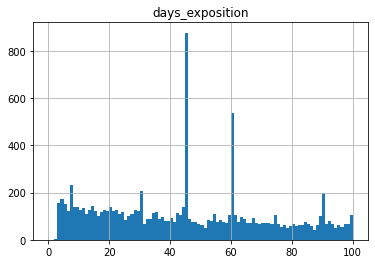

In [56]:
data.hist('days_exposition', bins=100, range = (0,100));
print(f'Среднее время продажи квартиры в днях:',int(data['days_exposition'].mean()))
print('Медианное время продажи квартиры в днях:',int(data['days_exposition'].median()))

print('Количество объявлений, которые сняты через:')
print('45 дней:',data[data['days_exposition']==45]['days_exposition'].count())
print('60 дней:',data[data['days_exposition']==60]['days_exposition'].count())
print('90 дней:',data[data['days_exposition']==90]['days_exposition'].count())

Видим,что чаще продажа занимает пол года,а 50% квартир продаются в срок до 3 месяцев. Продажи,которые занимают меньше месяца можно назвать необычно быстрыми, а 2 года и дольше — необычно долгими.Стоит отметить пики на графике:45,60,90 дней, объявления в этот период слетают по тайм-ауту.Так же стоит обратить внимание,что продажи после продления времени объявления в 90 дней и более уменьшаются,что говорит об эффективности данной процедуры. 

### Изучим какие факторы больше всего влияют на общую (полную) стоимость объекта.

In [57]:
factors = ['total_area',
                  'living_area',
                  'kitchen_area',
                  'rooms',
                  'day_week_publication',
                  'month_publication',
                  'year_publication']

for importance in factors:
    correlation = data['last_price'].corr(data[importance])
    print(f'Корреляция между last_price и {importance} составляет: {correlation:0.2%}')

Корреляция между last_price и total_area составляет: 62.45%
Корреляция между last_price и living_area составляет: 56.84%
Корреляция между last_price и kitchen_area составляет: 48.29%
Корреляция между last_price и rooms составляет: 35.29%
Корреляция между last_price и day_week_publication составляет: 0.50%
Корреляция между last_price и month_publication составляет: -0.04%
Корреляция между last_price и year_publication составляет: -4.36%



Дополним анализ графиками зависимости цены от параметров площадей и количества комнат. Для площадей подойдут диаграмма рассеяния, а для комнат выведим диаграмму как сделано ниже.

<Figure size 1152x1152 with 0 Axes>

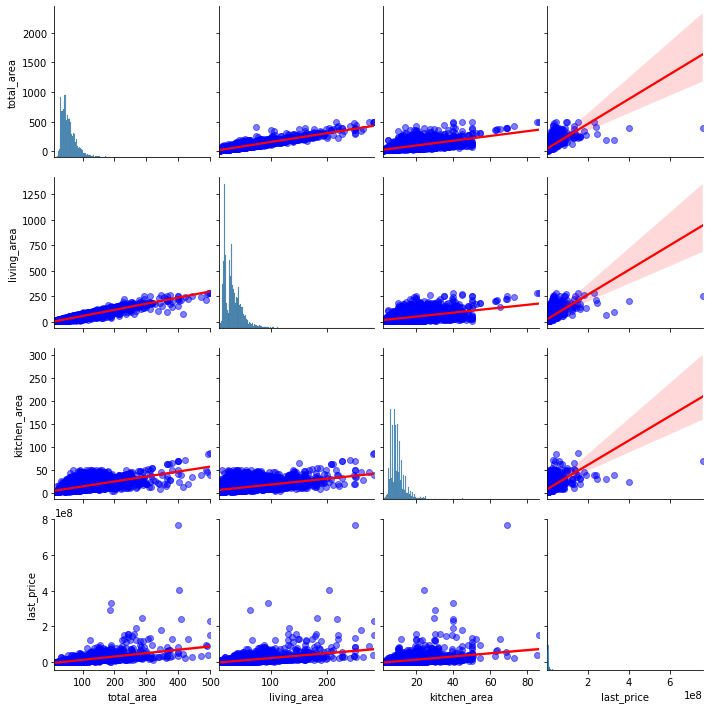

In [58]:
columns_to_plot = ['total_area', 'living_area', 'kitchen_area','last_price']

plt.figure(figsize=(16, 16))
g = sns.pairplot(data[columns_to_plot], kind='reg',  diag_kind='hist', plot_kws={'line_kws': {'color': 'red'},
                                                                  'scatter_kws': {'alpha': 0.5,
                                                                                  'color': 'blue'}})

plt.show()



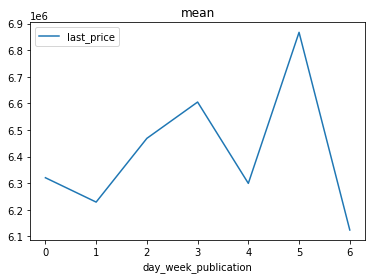

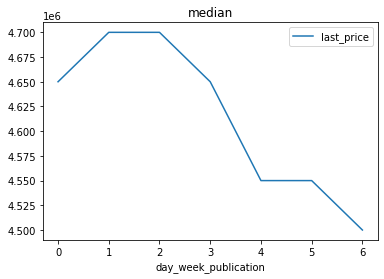

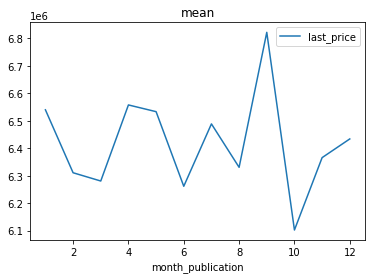

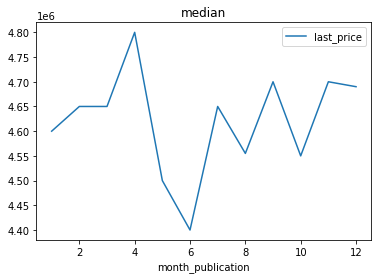

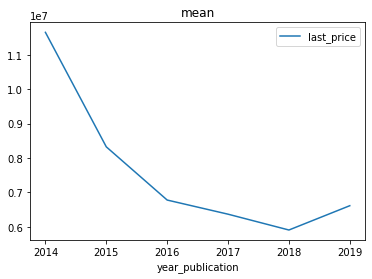

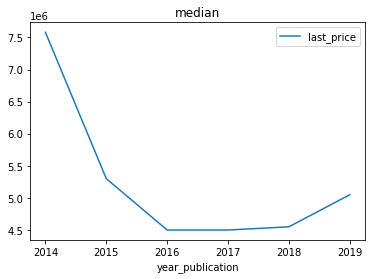

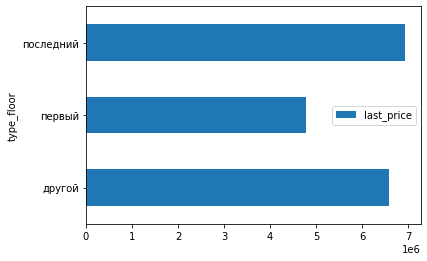

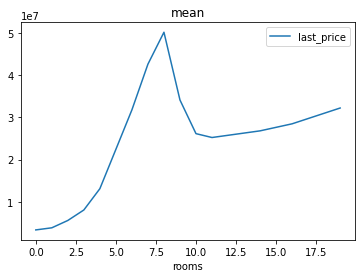

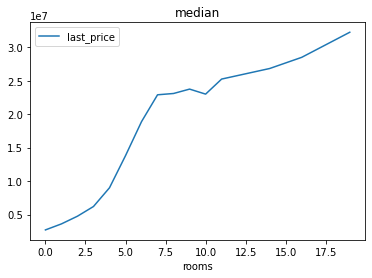

In [59]:
data.pivot_table(index='day_week_publication',values='last_price',aggfunc='mean').plot(y='last_price', kind='line', title='mean');
data.pivot_table(index='day_week_publication',values='last_price',aggfunc='median').plot(y='last_price', kind='line', title='median');

data.pivot_table(index='month_publication',values='last_price',aggfunc='mean').plot(y='last_price', kind='line', title='mean');
data.pivot_table(index='month_publication',values='last_price',aggfunc='median').plot(y='last_price', kind='line', title='median');

data.pivot_table(index='year_publication',values='last_price',aggfunc='mean').plot(y='last_price', kind='line', title='mean');
data.pivot_table(index='year_publication',values='last_price',aggfunc='median').plot(y='last_price', kind='line', title='median');

data.pivot_table(index='type_floor',values='last_price').plot(y='last_price', kind='barh');

data.pivot_table(index='rooms',values='last_price',aggfunc='mean').plot(y='last_price', kind='line', title='mean');
data.pivot_table(index='rooms',values='last_price',aggfunc='median').plot(y='last_price', kind='line', title='median');


Проанализировав диаграммы можно сделать вывод: цена на недвижимость зависит от площади квартиры(чем больше площадь, тем дороже квартиры),этажа(первый этаж дешевле),количество комнат(больше комнат-выше цена). Месяц,день публикации мы рассмотрели выше и отметили тайм-аут по датам размещения объявления. Год публикации отражает ценовую тенденцию в экономике в целом.

### Посчитаем среднюю цену одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений. Выделим населённые пункты с самой высокой и низкой стоимостью квадратного метра. 

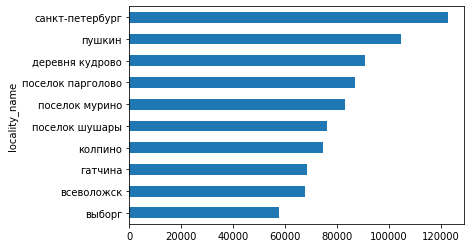

In [60]:
top_10 = data.pivot_table(index='locality_name', values=['last_price','total_area'] ,aggfunc=['sum','count'])
top_10.columns=['last_price_sum','total_area_sum','last_price_count','total_area_count']
top_10.pop('total_area_count')
top_10.sort_values(by=['last_price_count'],ascending=False, inplace=True)
top_10 = top_10.iloc[:10]
top_10['price_sq_m'] = top_10['last_price_sum']/top_10['total_area_sum']
top_10.sort_values(by=['price_sq_m'],ascending=True, inplace=True)
top_10['price_sq_m'].plot(kind='barh');

Анализируя среднюю цену одного квадратного метра в ТОП-10  населенных пунктах можно сделать вывод:самая дорогая недвижимость в Санкт-Петербурге.Так же в ТОП-10 входят ближайшие к Санкт-Петербургу населенные пункты.

### Ранее мы посчитали расстояние до центра в километрах. Теперь выделим квартиры в Санкт-Петербурге с помощью столбца locality_name и вычислим среднюю цену каждого километра. 

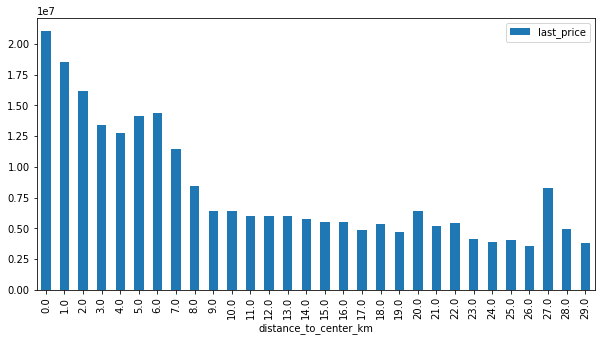

In [61]:
(
    data[data['locality_name']=='санкт-петербург']
    .pivot_table(
        index='distance_to_center_km',
        values='last_price',
        aggfunc='mean')
    .plot(kind='bar',figsize=(10,5))
);

Изучив как стоимость объектов зависит от расстояния до центра города,можно сделать вывод:самая востребованная недвижимость расположенна в радиусе 1км до центра.Далее наблюдаем спад цены и скачок на 27 км,скорее всего там расположен востребованная элитная недвижимость.

## **<p style="text-align: center;">Итоговый вывод.</p>**

**В ходе реализации проекта были сделаны следующие шаги:**
- ***Была проведена предобработка данных.*** Найдены и изученны пропущенные значения в столбцах. 
- ***Заполнены пропущенные значения там, где это возможно.*** Обработаны пропуски в площадях кухни и жилой площади. Восстановлены пропуски отталкиваясь от общей площади,медианным значением. Пропуски в столбце наличие балконов заменены на 0. Проанализировав во всех параметрах аномальные значения и выбросы, обрезаны совсем аномальные данные, так как выбросы сильно влияют на анализ и могут искажать истинные зависимости.
- ***Рассмотрены типы данных в каждом столбце.*** Найдены столбцы, в которых нужно изменить тип данных. Преобразовали тип данных в выбранных столбцах. Сменили тип данных для: last_price, first_day_exposition, floors_total, is_apartment, balcony,days_exposition. Изменили тип данных в столбце first_day_exposition на datetime, чтобы работать с датой в дальнейшем было удобно. Изменение типов во всех остальных случаях необходимо, чтобы сэкономить память.
- ***Изучили уникальные значения в столбце locality_name и устранили неявные дубликаты.*** Заменили букву ё на е в слове посёлок в колонке locality_name, а так же названия населённых пунктов привели к нижнему регистру. В столбце locality_name выявлены неявные дубликаты, избавились от них. Заменили "городской поселок" на "поселок","поселок городского типа" на "поселок" .
- ***Посчитали и добавили в таблицу новые столбцы.*** Добавили в таблицу новый столбец  price_os_meter со следующими параметрами: цена одного квадратного метра. Добавили в таблицу новый столбец  day_week_publication со следующими параметрами: день недели публикации объявления (0 — понедельник, 1 — вторник и так далее). Добавим в таблицу новый столбец  month_publication со следующими параметрами: месяц и год  публикации объявления. Добавили в таблицу новый столбец  type _floor со следующими параметрами:тип этажа квартиры (значения — «первый», «последний», «другой»). Добавим в таблицу новый столбец distance_to_center_km со следующими параметрами: расстояние до центра города в километрах (перевели из м в км и округлили до целых значений).
- ***Проведя исследовательский анализ данных можно сделать вывод:*** цена на недвижимость зависит от плащади квартиры(чем больше площадь,тем выше цена), этажа(первый этаж дешевле), количества комнат(больше комнат-выше цена). Анализируя месяц,день публикации мы выявили  тайм-аут  времени размещения объявления. Год публикации отражает ценовую тенденцию в экономике в целом. Анализируя среднюю цену одного квадратного метра в ТОП-10 населенных пунктах можно сделать вывод:самая дорогая недвижимость в Санкт-Петербурге.Так же в ТОП-10 входят ближайшие к Санкт-Петербургу населенные пункты. Изучив как стоимость объектов зависит от расстояния до центра города,можно сделать вывод:самая востребованная недвижимость расположенна в радиусе 1км до центра.Далее наблюдаем спад цены и скачок на 27 км,скорее всего там расположен востребованная элитная недвижимость.
